In [57]:
import numpy as np
import os
from transformers import AutoTokenizer
import scipy.sparse as sp
from collections import defaultdict
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from collections import Counter
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

In [2]:
docs = []
labels = []

data_path = "dataset/mini_newsgroups"

for folder in os.listdir(data_path):
    folder_path = os.path.join(data_path, folder)
    if os.path.isdir(folder_path):
        for filename in os.listdir(folder_path):
            file_path = os.path.join(folder_path, filename)
            with open(file_path, 'r', encoding='latin1') as f:
                docs.append(f.read())
                labels.append(folder)

In [3]:
docs

["Path: cantaloupe.srv.cs.cmu.edu!magnesium.club.cc.cmu.edu!news.sei.cmu.edu!bb3.andrew.cmu.edu!andrew.cmu.edu!ssbc+\nFrom: Sam Swett <ssbc+@andrew.cmu.edu>\nNewsgroups: rec.autos\nSubject: Re: REVIEW: 1989 Ford Taurus SHO\nDate: Tue, 27 Apr 1993 00:46:52 -0400\nOrganization: Freshman, H&SS general, Carnegie Mellon, Pittsburgh, PA\nLines: 28\nMessage-ID: <kfr=ewC00WA1Q6wtt7@andrew.cmu.edu>\nNNTP-Posting-Host: po4.andrew.cmu.edu\nIn-Reply-To: <1993Apr26.204845.24623@ncrcae.ColumbiaSC.NCR.COM>\n\nExcerpts from rec.autos: 26-Apr-93 Re: REVIEW: 1989 Ford Tauru.. by Mark\nW. Rice@mozart.Colu \n> In article <24326.74.uupcb@cutting.hou.tx.us>\ndavid.bonds@cutting.hou.tx.us (Dav\n> id Bonds)  writes:\n> >\n> >GK>Occasionally, I have trouble shifting into reverse.  The shifter\n> >GK>refuses to enter the gate, and I often grind the synchros trying to\n> >GK>get it into gear.  I'll be watching this carefully in the next couple\n> >GK>of months.\n> >\n> >Enter 1st, wait 2-3 seconds and then go in

In [4]:
len(docs)

2000

In [5]:
tokenizer = AutoTokenizer.from_pretrained("gpt2")

In [6]:
tokenized_docs = [tokenizer.backend_tokenizer.pre_tokenizer.pre_tokenize_str(doc) for doc in docs]

In [7]:
tokenized_docs

[[('Path', (0, 4)),
  (':', (4, 5)),
  ('Ġcantaloupe', (5, 16)),
  ('.', (16, 17)),
  ('srv', (17, 20)),
  ('.', (20, 21)),
  ('cs', (21, 23)),
  ('.', (23, 24)),
  ('cmu', (24, 27)),
  ('.', (27, 28)),
  ('edu', (28, 31)),
  ('!', (31, 32)),
  ('magnesium', (32, 41)),
  ('.', (41, 42)),
  ('club', (42, 46)),
  ('.', (46, 47)),
  ('cc', (47, 49)),
  ('.', (49, 50)),
  ('cmu', (50, 53)),
  ('.', (53, 54)),
  ('edu', (54, 57)),
  ('!', (57, 58)),
  ('news', (58, 62)),
  ('.', (62, 63)),
  ('sei', (63, 66)),
  ('.', (66, 67)),
  ('cmu', (67, 70)),
  ('.', (70, 71)),
  ('edu', (71, 74)),
  ('!', (74, 75)),
  ('bb', (75, 77)),
  ('3', (77, 78)),
  ('.', (78, 79)),
  ('andrew', (79, 85)),
  ('.', (85, 86)),
  ('cmu', (86, 89)),
  ('.', (89, 90)),
  ('edu', (90, 93)),
  ('!', (93, 94)),
  ('andrew', (94, 100)),
  ('.', (100, 101)),
  ('cmu', (101, 104)),
  ('.', (104, 105)),
  ('edu', (105, 108)),
  ('!', (108, 109)),
  ('ssbc', (109, 113)),
  ('+', (113, 114)),
  ('Ċ', (114, 115)),
  ('From'

In [8]:
tokens_freqs = dict()

In [9]:
for single_document in docs:
    tokenized_document = tokenized_text = tokenizer.backend_tokenizer.pre_tokenizer.pre_tokenize_str(single_document)

    tokens = list()
    for token,location in tokenized_document:
        tokens.append(token)

    for token in tokens:
        if token not in tokens_freqs.keys():
            tokens_freqs[token] = 1
        else:
            tokens_freqs[token] += 1

In [10]:
tokens_freqs

{'Path': 2010,
 ':': 35728,
 'Ġcantaloupe': 2629,
 '.': 117428,
 'srv': 3243,
 'cs': 4477,
 'cmu': 5299,
 'edu': 15698,
 '!': 20708,
 'magnesium': 460,
 'club': 460,
 'cc': 903,
 'news': 2305,
 'sei': 650,
 'bb': 261,
 '3': 1762,
 'andrew': 375,
 'ssbc': 2,
 '+': 973,
 'Ċ': 84198,
 'From': 2095,
 'ĠSam': 10,
 'ĠSwett': 1,
 'Ġ<': 6255,
 '+@': 81,
 '>': 16551,
 'Newsgroups': 2016,
 'Ġrec': 575,
 'autos': 182,
 'Subject': 2077,
 'ĠRe': 1406,
 'ĠREVIEW': 2,
 'Ġ1989': 29,
 'ĠFord': 23,
 'ĠTaurus': 8,
 'ĠSHO': 7,
 'Date': 2028,
 'ĠTue': 234,
 ',': 29180,
 'Ġ27': 155,
 'ĠApr': 1984,
 'Ġ1993': 1473,
 'Ġ00': 188,
 '46': 107,
 '52': 87,
 'Ġ-': 1893,
 '0400': 70,
 'Organization': 1934,
 'ĠFreshman': 5,
 'ĠH': 121,
 '&': 343,
 'SS': 13,
 'Ġgeneral': 116,
 'ĠCarnegie': 29,
 'ĠMellon': 32,
 'ĠPittsburgh': 52,
 'ĠPA': 29,
 'Lines': 2003,
 'Ġ28': 104,
 'Message': 2010,
 '-': 16379,
 'ID': 2017,
 'kfr': 1,
 '=': 482,
 'ewC': 1,
 '00': 543,
 'WA': 13,
 '1': 3792,
 'Q': 353,
 '6': 1817,
 'wtt': 1,
 '7': 

In [11]:
len(tokens_freqs)

72636

In [12]:
vocab = list()

for token in tokens_freqs.keys():
  for char in token:
    if char not in vocab:
      vocab.append(char)

In [13]:
print(vocab)

['P', 'a', 't', 'h', ':', 'Ġ', 'c', 'n', 'l', 'o', 'u', 'p', 'e', '.', 's', 'r', 'v', 'm', 'd', '!', 'g', 'i', 'b', 'w', '3', '+', 'Ċ', 'F', 'S', '<', '@', '>', 'N', 'j', 'R', 'E', 'V', 'I', 'W', '1', '9', '8', 'T', 'H', 'O', 'D', ',', '2', '7', 'A', '0', '4', '6', '5', '-', 'z', '&', 'C', 'M', 'L', 'k', 'f', '=', 'Q', 'y', 'x', '(', 'B', ')', 'G', 'K', "'", 'q', '*', 'Y', 'J', 'U', '|', '?', '$', '"', 'X', '/', '[', ']', '_', '\\', 'Z', ';', '%', '~', '#', '^', 'ĉ', '}', '`', '{', 'Â', 'ª', '«', '§', '»', 'Đ', 'ę', 'ġ', 'Ã', '¸', 'Ħ', '¥', 'ě', '¾', '½', 'ĳ', 'Ģ', 'Ĉ', 'Č', 'Ĝ']


In [14]:
len(vocab)

117

In [15]:
each_pretokenized_token_splits = dict()

In [16]:
for token in tokens_freqs.keys():
  each_pretokenized_token_splits[token] = list()

  for char in token:
    each_pretokenized_token_splits[token].append(char)

In [17]:
print(each_pretokenized_token_splits)

{'Path': ['P', 'a', 't', 'h'], ':': [':'], 'Ġcantaloupe': ['Ġ', 'c', 'a', 'n', 't', 'a', 'l', 'o', 'u', 'p', 'e'], '.': ['.'], 'srv': ['s', 'r', 'v'], 'cs': ['c', 's'], 'cmu': ['c', 'm', 'u'], 'edu': ['e', 'd', 'u'], '!': ['!'], 'magnesium': ['m', 'a', 'g', 'n', 'e', 's', 'i', 'u', 'm'], 'club': ['c', 'l', 'u', 'b'], 'cc': ['c', 'c'], 'news': ['n', 'e', 'w', 's'], 'sei': ['s', 'e', 'i'], 'bb': ['b', 'b'], '3': ['3'], 'andrew': ['a', 'n', 'd', 'r', 'e', 'w'], 'ssbc': ['s', 's', 'b', 'c'], '+': ['+'], 'Ċ': ['Ċ'], 'From': ['F', 'r', 'o', 'm'], 'ĠSam': ['Ġ', 'S', 'a', 'm'], 'ĠSwett': ['Ġ', 'S', 'w', 'e', 't', 't'], 'Ġ<': ['Ġ', '<'], '+@': ['+', '@'], '>': ['>'], 'Newsgroups': ['N', 'e', 'w', 's', 'g', 'r', 'o', 'u', 'p', 's'], 'Ġrec': ['Ġ', 'r', 'e', 'c'], 'autos': ['a', 'u', 't', 'o', 's'], 'Subject': ['S', 'u', 'b', 'j', 'e', 'c', 't'], 'ĠRe': ['Ġ', 'R', 'e'], 'ĠREVIEW': ['Ġ', 'R', 'E', 'V', 'I', 'E', 'W'], 'Ġ1989': ['Ġ', '1', '9', '8', '9'], 'ĠFord': ['Ġ', 'F', 'o', 'r', 'd'], 'ĠTaurus'

In [18]:
def compute_byte_pair_freq(each_pretokenized_token_splits):
  byte_pairs_freqs = defaultdict(int)

  for token in each_pretokenized_token_splits.keys():
    char_list = each_pretokenized_token_splits[token]

    if len(char_list) == 1:
      continue

    for i in range(len(char_list)-1):
      byte_pair = (char_list[i],char_list[i+1])
      byte_pairs_freqs[byte_pair] += 1

  return byte_pairs_freqs

In [19]:
def introduce_newly_created_byte_pair(left_byte, right_byte, each_pretokenized_token_splits):
    for token in each_pretokenized_token_splits.keys():
        char_list = each_pretokenized_token_splits[token]

        if len(char_list) == 1:
            continue

        i = 0
        while i < len(char_list) - 1:
            if char_list[i] == left_byte and char_list[i + 1] == right_byte:
                char_list = char_list[:i] + [left_byte + right_byte] + char_list[i + 2:]
            else:
                i += 1

        each_pretokenized_token_splits[token] = char_list

    return each_pretokenized_token_splits

In [20]:
vocab_size = 200
newly_created_byte_pairs = dict()

while len(vocab) < vocab_size:
    byte_pairs_freqs = compute_byte_pair_freq(each_pretokenized_token_splits)

    if not byte_pairs_freqs:
        break 

    max_freq_byte_pair = max(byte_pairs_freqs.items(), key=lambda x: x[1])[0]
    merged_token = max_freq_byte_pair[0] + max_freq_byte_pair[1]

    if merged_token in vocab:
        continue

    vocab.append(merged_token)
    newly_created_byte_pairs[max_freq_byte_pair] = merged_token

    each_pretokenized_token_splits = introduce_newly_created_byte_pair(
        max_freq_byte_pair[0],
        max_freq_byte_pair[1],
        each_pretokenized_token_splits
    )

In [21]:
newly_created_byte_pairs

{('Ġ', 'Ġ'): 'ĠĠ',
 ('-', '-'): '--',
 ('e', 'r'): 'er',
 ('i', 'n'): 'in',
 ('ĠĠ', 'ĠĠ'): 'ĠĠĠĠ',
 ('o', 'n'): 'on',
 ('e', 's'): 'es',
 ('--', '--'): '----',
 ('a', 'n'): 'an',
 ('e', 'n'): 'en',
 ('=', '='): '==',
 ('a', 't'): 'at',
 ('a', 'r'): 'ar',
 ('e', 'd'): 'ed',
 ('_', '_'): '__',
 ('a', 'l'): 'al',
 ('o', 'r'): 'or',
 ('in', 'g'): 'ing',
 ('s', 't'): 'st',
 ('ĠĠĠĠ', 'ĠĠĠĠ'): 'ĠĠĠĠĠĠĠĠ',
 ('i', 'c'): 'ic',
 ('r', 'e'): 're',
 ('i', 't'): 'it',
 ('Ġ', 'c'): 'Ġc',
 ('e', 'l'): 'el',
 ('i', 'on'): 'ion',
 ('i', 's'): 'is',
 ('Ġ', 's'): 'Ġs',
 ('----', '----'): '--------',
 ('==', '=='): '====',
 ('l', 'e'): 'le',
 ('*', '*'): '**',
 ('r', 'o'): 'ro',
 ('Ġ', 'p'): 'Ġp',
 ('a', 'c'): 'ac',
 ('Ġ', 'S'): 'ĠS',
 ('u', 'n'): 'un',
 ('__', '__'): '____',
 ('Ġ', 'd'): 'Ġd',
 ('en', 't'): 'ent',
 ('e', 't'): 'et',
 ('i', 'l'): 'il',
 ('a', 's'): 'as',
 ('o', 'l'): 'ol',
 ('Ġ', 'C'): 'ĠC',
 ('o', 'm'): 'om',
 ('r', 'a'): 'ra',
 ('.', '.'): '..',
 ('Ġ', 'M'): 'ĠM',
 ('u', 'r'): 'ur',
 ('e

In [22]:
def bpe_tokenize(text):
    pre_tokenized_result = tokenizer.backend_tokenizer.pre_tokenizer.pre_tokenize_str(text)
    pre_tokenized_text = [token for token, _ in pre_tokenized_result]
    output_tokens = []

    for token in pre_tokenized_text:
        char_list = list(token)

        for byte_pair, merged_token in newly_created_byte_pairs.items():
            i = 0
            while i < len(char_list) - 1:
                if char_list[i] == byte_pair[0] and char_list[i + 1] == byte_pair[1]:
                    char_list = char_list[:i] + [merged_token] + char_list[i + 2:]
                else:
                    i += 1

        output_tokens.extend(char_list)

    return output_tokens

In [24]:
bpe_tokenized_docs = []

for single_document in docs:
    bpe_tokenized_docs.append(bpe_tokenize(single_document))

In [25]:
vocab_token_to_idx = dict(zip(vocab, range(len(vocab))))

In [26]:
print(vocab_token_to_idx)

{'P': 0, 'a': 1, 't': 2, 'h': 3, ':': 4, 'Ġ': 5, 'c': 6, 'n': 7, 'l': 8, 'o': 9, 'u': 10, 'p': 11, 'e': 12, '.': 13, 's': 14, 'r': 15, 'v': 16, 'm': 17, 'd': 18, '!': 19, 'g': 20, 'i': 21, 'b': 22, 'w': 23, '3': 24, '+': 25, 'Ċ': 26, 'F': 27, 'S': 28, '<': 29, '@': 30, '>': 31, 'N': 32, 'j': 33, 'R': 34, 'E': 35, 'V': 36, 'I': 37, 'W': 38, '1': 39, '9': 40, '8': 41, 'T': 42, 'H': 43, 'O': 44, 'D': 45, ',': 46, '2': 47, '7': 48, 'A': 49, '0': 50, '4': 51, '6': 52, '5': 53, '-': 54, 'z': 55, '&': 56, 'C': 57, 'M': 58, 'L': 59, 'k': 60, 'f': 61, '=': 62, 'Q': 63, 'y': 64, 'x': 65, '(': 66, 'B': 67, ')': 68, 'G': 69, 'K': 70, "'": 71, 'q': 72, '*': 73, 'Y': 74, 'J': 75, 'U': 76, '|': 77, '?': 78, '$': 79, '"': 80, 'X': 81, '/': 82, '[': 83, ']': 84, '_': 85, '\\': 86, 'Z': 87, ';': 88, '%': 89, '~': 90, '#': 91, '^': 92, 'ĉ': 93, '}': 94, '`': 95, '{': 96, 'Â': 97, 'ª': 98, '«': 99, '§': 100, '»': 101, 'Đ': 102, 'ę': 103, 'ġ': 104, 'Ã': 105, '¸': 106, 'Ħ': 107, '¥': 108, 'ě': 109, '¾': 110

In [27]:
rows = list()
columns = list()
term_frequency = list()

for document_id, tokenized_document in enumerate(bpe_tokenized_docs):
  term_frequencies = dict()

  for token in tokenized_document:
    idx = vocab_token_to_idx[token]
    term_frequencies[idx] = term_frequencies.get(idx,0) + 1


  for idx, frequency in term_frequencies.items():
    rows.append(document_id)
    columns.append(idx)
    term_frequency.append(frequency)

In [28]:
tf_matrix = sp.csr_matrix((term_frequency,(rows,columns)),shape=(len(docs),len(vocab_token_to_idx)))

In [29]:
tf_matrix

<Compressed Sparse Row sparse matrix of dtype 'int64'
	with 263968 stored elements and shape (2000, 200)>

In [30]:
tf_idf_transformer = TfidfTransformer()

In [31]:
tf_idf_transformer.fit(tf_matrix)

,norm,'l2'
,use_idf,True
,smooth_idf,True
,sublinear_tf,False


In [32]:
tf_idf_matrix = tf_idf_transformer.transform(tf_matrix)

In [33]:
tf_idf_matrix.shape

(2000, 200)

In [34]:
tf_idf_matrix = tf_idf_matrix.toarray()

In [35]:
tf_idf_matrix

array([[0.01495511, 0.08973068, 0.18444639, ..., 0.        , 0.        ,
        0.        ],
       [0.00359975, 0.08639405, 0.11519206, ..., 0.        , 0.04216386,
        0.02197523],
       [0.01255636, 0.1004509 , 0.12556363, ..., 0.        , 0.01838407,
        0.        ],
       ...,
       [0.00679129, 0.09507801, 0.16978215, ..., 0.        , 0.        ,
        0.        ],
       [0.01735913, 0.09836841, 0.12151392, ..., 0.        , 0.00847197,
        0.        ],
       [0.02009751, 0.08039006, 0.09244856, ..., 0.        , 0.        ,
        0.        ]])

In [36]:
factorized_tf_idf = np.linalg.svd(tf_idf_matrix)

In [37]:
factorized_tf_idf

SVDResult(U=array([[-2.34244574e-02,  7.99795411e-03, -1.86112099e-03, ...,
        -1.21576847e-02, -2.32242272e-02, -2.35776490e-02],
       [-2.16140103e-02,  1.62506759e-02, -3.06218674e-02, ...,
        -1.71195676e-02, -1.54644553e-02,  5.79208975e-03],
       [-2.27887319e-02, -6.86991317e-03, -2.62413360e-02, ...,
        -3.55570689e-02, -1.65823811e-02,  4.43448972e-03],
       ...,
       [-2.20469567e-02,  2.25739279e-02, -1.06929879e-03, ...,
         9.36539218e-01,  4.87409996e-03, -7.46270302e-03],
       [-2.23908537e-02, -1.24650469e-02,  1.24907146e-02, ...,
         5.16221336e-03,  7.64364926e-01,  6.58310780e-03],
       [-2.33632383e-02, -6.60448663e-04, -1.14733300e-03, ...,
        -8.29594593e-03,  4.92083447e-03,  9.25707398e-01]]), S=array([4.14960054e+01, 7.61939475e+00, 3.84903268e+00, 3.10221365e+00,
       2.94679054e+00, 2.81177909e+00, 2.67418709e+00, 2.55528566e+00,
       2.52497218e+00, 2.43669630e+00, 2.33026343e+00, 2.30573034e+00,
       2.197770

In [38]:
Vt = factorized_tf_idf[2]

In [39]:
Vt

array([[-1.60409528e-02, -1.20440537e-01, -1.28765246e-01, ...,
        -3.25721609e-03, -1.04996310e-02, -1.02713273e-02],
       [-3.06723675e-02, -3.49038537e-03, -1.23260072e-02, ...,
        -3.69831960e-03, -3.80270187e-03, -3.40260998e-03],
       [-2.11692987e-02,  4.71625580e-02,  6.64459889e-02, ...,
        -6.62752635e-02, -2.24454958e-02, -8.50157368e-02],
       ...,
       [ 0.00000000e+00, -2.34632112e-17,  8.11857455e-19, ...,
        -3.31009740e-17,  2.14145299e-16, -3.92810166e-17],
       [ 0.00000000e+00, -6.91124041e-18,  7.04011604e-18, ...,
         9.18175337e-18,  6.54237665e-17,  6.21886006e-17],
       [ 0.00000000e+00, -1.66131916e-17,  5.86847134e-18, ...,
        -4.39002741e-17, -2.90921782e-17, -1.37123799e-16]])

In [40]:
Vt.shape

(200, 200)

In [41]:
bpe_tokenized_docs[0]

['P',
 'at',
 'h',
 ':',
 'Ġc',
 'an',
 't',
 'al',
 'o',
 'u',
 'p',
 'e',
 '.',
 's',
 'r',
 'v',
 '.',
 'c',
 's',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '!',
 'm',
 'a',
 'g',
 'n',
 'es',
 'i',
 'u',
 'm',
 '.',
 'c',
 'l',
 'u',
 'b',
 '.',
 'c',
 'c',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '!',
 'n',
 'e',
 'w',
 's',
 '.',
 's',
 'e',
 'i',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '!',
 'b',
 'b',
 '3',
 '.',
 'an',
 'd',
 're',
 'w',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '!',
 'an',
 'd',
 're',
 'w',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '!',
 's',
 's',
 'b',
 'c',
 '+',
 'Ċ',
 'F',
 'ro',
 'm',
 ':',
 'ĠS',
 'am',
 'ĠS',
 'w',
 'et',
 't',
 'Ġ',
 '<',
 's',
 's',
 'b',
 'c',
 '+',
 '@',
 'an',
 'd',
 're',
 'w',
 '.',
 'c',
 'm',
 'u',
 '.',
 'ed',
 'u',
 '>',
 'Ċ',
 'N',
 'e',
 'w',
 's',
 'g',
 'ro',
 'u',
 'p',
 's',
 ':',
 'Ġ',
 're',
 'c',
 '.',
 'a',
 'ut',
 'os',
 'Ċ',
 'S',
 'u',
 'b',
 'j',
 'ec',
 't',
 ':',
 'Ġ',
 'R',
 'e',
 ':',
 'Ġ',
 

In [42]:
k = 20
kmeans = KMeans(n_clusters=k, random_state=42)
clusters = kmeans.fit_predict(tf_idf_matrix)

In [43]:
print(clusters[:10])

[1 6 0 5 4 2 2 2 4 5]


In [44]:
cluster_counts = Counter(clusters)
print("Document count per cluster:\n")
for cluster_id, count in sorted(cluster_counts.items()):
    print(f"Cluster {cluster_id}: {count} documents")

Document count per cluster:

Cluster 0: 150 documents
Cluster 1: 262 documents
Cluster 2: 248 documents
Cluster 3: 85 documents
Cluster 4: 99 documents
Cluster 5: 180 documents
Cluster 6: 28 documents
Cluster 7: 30 documents
Cluster 8: 13 documents
Cluster 9: 8 documents
Cluster 10: 29 documents
Cluster 11: 42 documents
Cluster 12: 30 documents
Cluster 13: 20 documents
Cluster 14: 233 documents
Cluster 15: 118 documents
Cluster 16: 7 documents
Cluster 17: 1 documents
Cluster 18: 175 documents
Cluster 19: 242 documents


In [45]:
kmeans_labels = kmeans.labels_

In [46]:
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words='english')
tf = vectorizer.fit_transform(docs)

In [47]:
lda_model = LatentDirichletAllocation(n_components=20, random_state=42)
lda_model.fit(tf)

,n_components,20
,doc_topic_prior,None
,topic_word_prior,None
,learning_method,'batch'
,learning_decay,0.7
,learning_offset,10.0
,max_iter,10
,batch_size,128
,evaluate_every,-1
,total_samples,1000000.0
,perp_tol,0.1


In [48]:
def display_topics(model, feature_names, no_top_words=10):
    for topic_idx, topic in enumerate(model.components_):
        print(f"\n Topic #{topic_idx}")
        top_features = [feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
        print("Top words:", " | ".join(top_features))

display_topics(lda_model, vectorizer.get_feature_names_out(), 10)


 Topic #0
Top words: god | com | people | don | say | think | christian | just | jesus | writes

 Topic #1
Top words: jpeg | image | file | entry | gif | images | format | files | use | frank

 Topic #2
Top words: uiuc | news | cso | state | government | gun | ohio | law | encryption | information

 Topic #3
Top words: com | news | net | uiuc | talk | writes | culture | apr | soc | references

 Topic #4
Top words: mr | com | state | know | think | don | news | ohio | president | article

 Topic #5
Top words: com | news | apr | net | oracle | gmt | 1993 | mit | alaska | posting

 Topic #6
Top words: com | net | news | apr | gmt | ans | howland | reston | hp | eng

 Topic #7
Top words: windows | dos | ms | os | comp | graphics | 00 | image | software | data

 Topic #8
Top words: space | nasa | gov | sci | caltech | launch | shuttle | jpl | venus | com

 Topic #9
Top words: com | rutgers | 25 | net | news | christian | people | ca | god | religion

 Topic #10
Top words: state | ohio | ne

In [49]:
doc_topic_dist = lda_model.transform(tf)

In [50]:
dominant_topic = doc_topic_dist.argmax(axis=1)

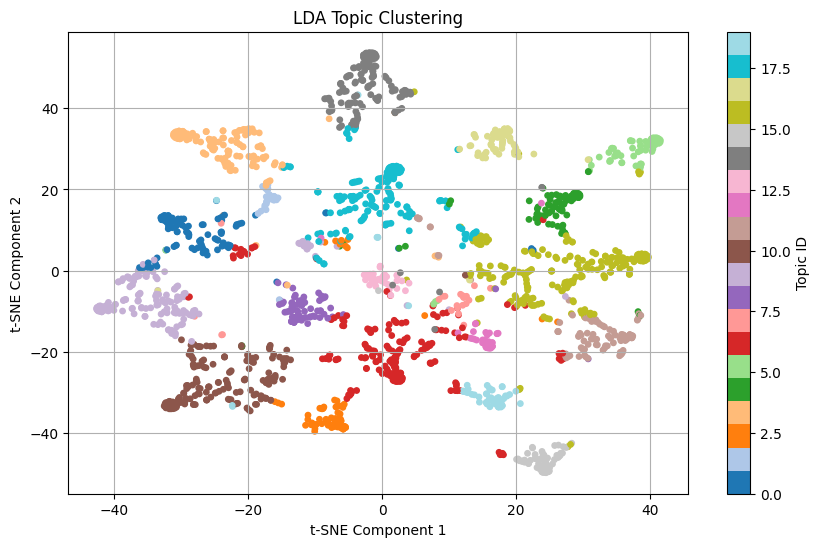

In [51]:
tsne_model = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_points = tsne_model.fit_transform(doc_topic_dist)

plt.figure(figsize=(10, 6))
scatter = plt.scatter(tsne_points[:, 0], tsne_points[:, 1],
                      c=dominant_topic, cmap='tab20', s=15)
plt.title("LDA Topic Clustering")
plt.xlabel("t-SNE Component 1")
plt.ylabel("t-SNE Component 2")
plt.colorbar(scatter, label="Topic ID")
plt.grid(True)
plt.show()

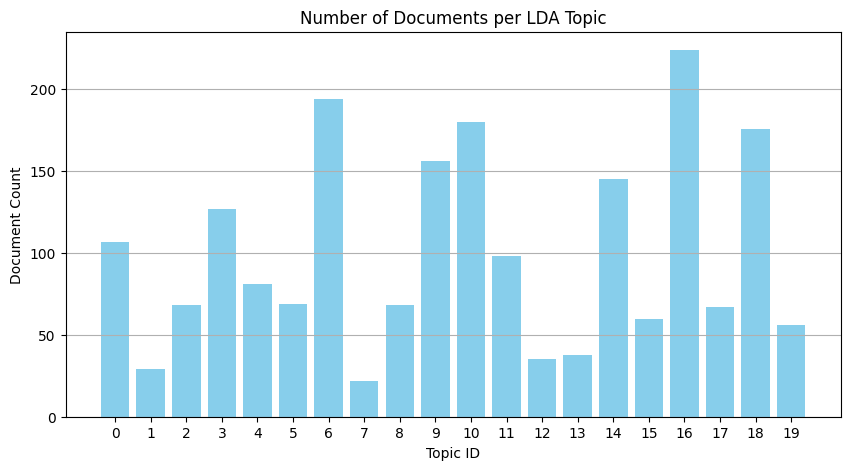

In [52]:
topic_counts = Counter(dominant_topic)

plt.figure(figsize=(10, 5))
plt.bar(topic_counts.keys(), topic_counts.values(), color='skyblue')
plt.title("Number of Documents per LDA Topic")
plt.xlabel("Topic ID")
plt.ylabel("Document Count")
plt.xticks(list(topic_counts.keys()))
plt.grid(axis='y')
plt.show()

In [53]:
comparison_data = pd.DataFrame({
    'KMeans_Cluster': kmeans_labels,
    'LDA_Topic': dominant_topic
})

In [54]:
confusion_matrix = pd.crosstab(comparison_data['KMeans_Cluster'], comparison_data['LDA_Topic'])

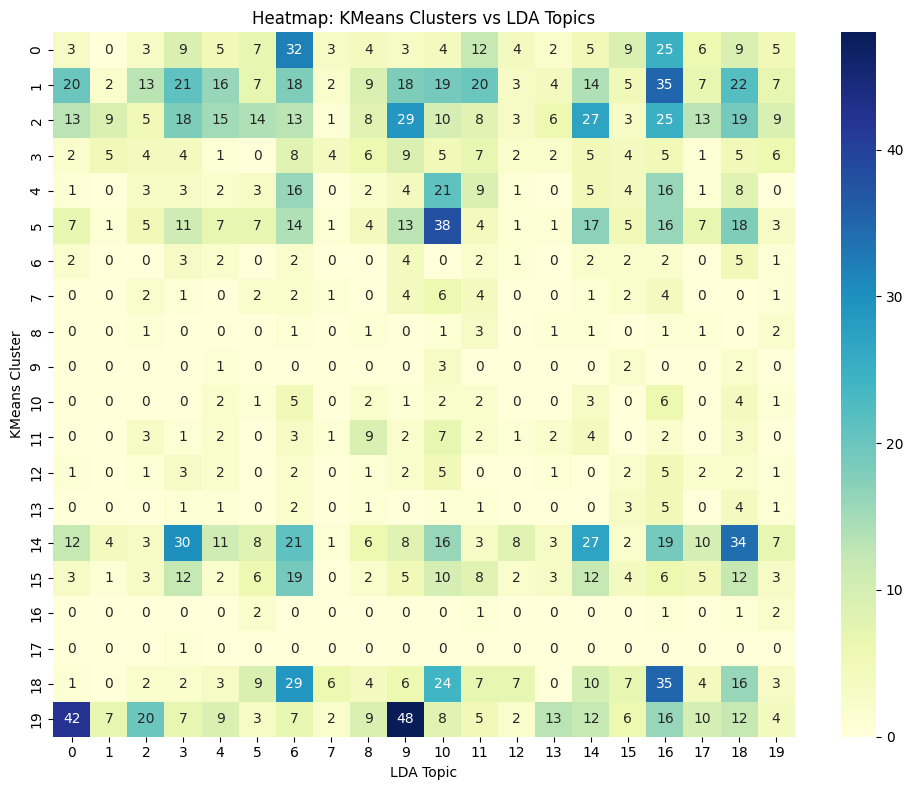

In [55]:
plt.figure(figsize=(10, 8))
sns.heatmap(confusion_matrix, annot=True, fmt='d', cmap='YlGnBu')
plt.title("Heatmap: KMeans Clusters vs LDA Topics")
plt.xlabel("LDA Topic")
plt.ylabel("KMeans Cluster")
plt.tight_layout()
plt.show()

<Axes: xlabel='LDA_Topic', ylabel='KMeans_Cluster'>

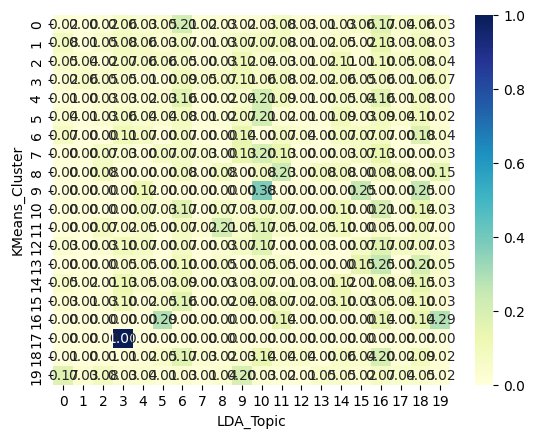

In [56]:
normalized = confusion_matrix.div(confusion_matrix.sum(axis=1), axis=0)
sns.heatmap(normalized, annot=True, fmt=".2f", cmap='YlGnBu')

In [58]:
ari = adjusted_rand_score(dominant_topic, kmeans_labels)
nmi = normalized_mutual_info_score(dominant_topic, kmeans_labels)

print(f"Adjusted Rand Index (ARI): {ari:.3f}")
print(f"Normalized Mutual Info (NMI): {nmi:.3f}")

Adjusted Rand Index (ARI): 0.018
Normalized Mutual Info (NMI): 0.076
